# Exploratory Data Analysis File

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import re
import os
import tensorflow as tf
import plotly.express as px

from scipy.stats import skew
from tqdm import tqdm


In [2]:
file_path = 'Data/oasis_data'
# List all items in data_path and filter out '.DS_Store' and any other non-directory items
classes = [item for item in os.listdir(file_path) if os.path.isdir(os.path.join(file_path, item)) and item != '.DS_Store']
print(classes)

# Map directory names to lists
categories = {
    'Non Demented': [],
    'Very mild Dementia': [],
    'Mild Dementia': [],
    'Moderate Dementia': []
}

image_extensions = '.jpg'  # Image extensions

base_dir = 'Data/oasis_data/'

# Loop through each category
for category in categories.keys():
    dir_path = os.path.join(base_dir, category)
    for dirname, _, filenames in os.walk(dir_path):
        for filename in filenames:
            if os.path.splitext(filename)[1].lower() in image_extensions:
                categories[category].append(os.path.join(dirname, filename))

# lists of the directories
non_demented = categories['Non Demented']
very_mild_demented = categories['Very mild Dementia']
mild_demented = categories['Mild Dementia']
moderate_demented = categories['Moderate Dementia']


print("Number of Non Demented Images:      ", len(non_demented))
print("Number of Very Mild Demented Images:", len(very_mild_demented))
print("Number of Mild Demented Images:     ", len(mild_demented))
print("Number of Moderate Demented Images: ", len(moderate_demented))

['Mild Dementia', 'Moderate Dementia', 'Non Demented', 'Very mild Dementia']
Number of Non Demented Images:       67222
Number of Very Mild Demented Images: 13725
Number of Mild Demented Images:      5002
Number of Moderate Demented Images:  488


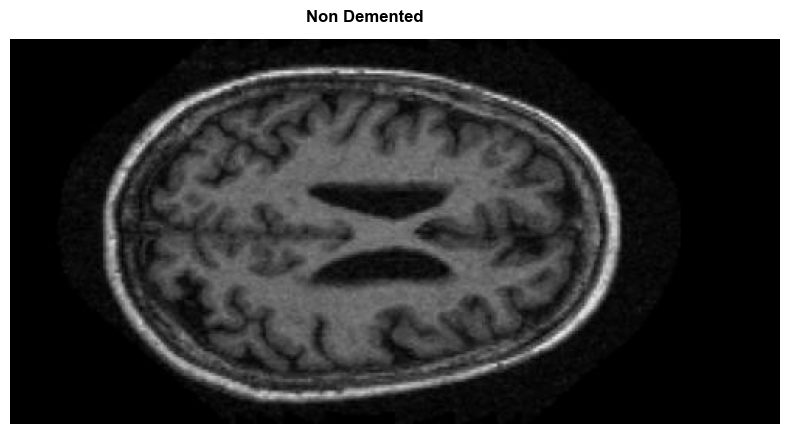

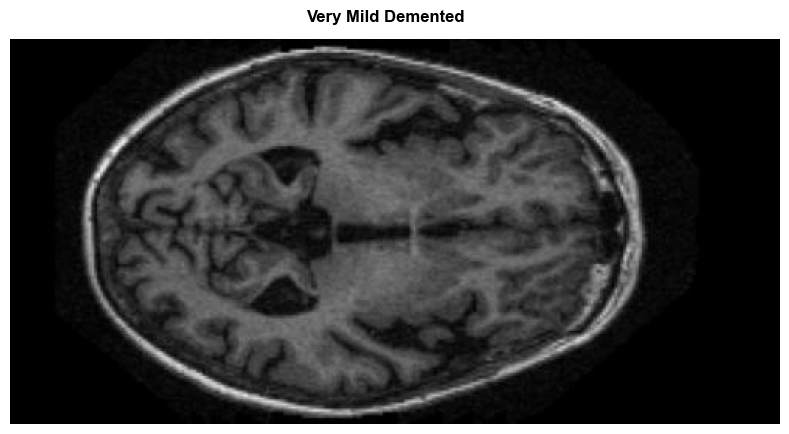

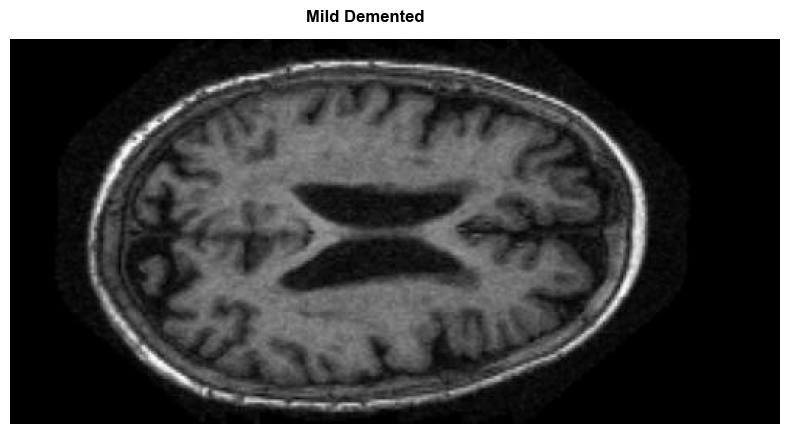

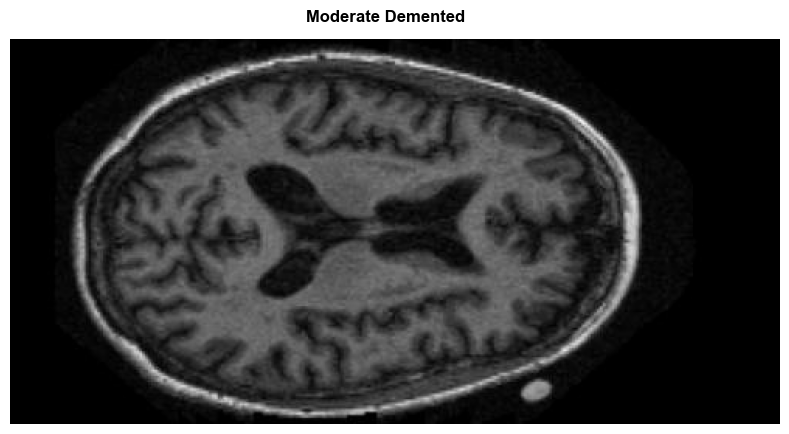

In [3]:
from PIL import Image
import matplotlib.pyplot as plt

# Function to display images with text indicating the category
def display_images(file_paths, category_name, endings=['155']):
    plt.figure(figsize=(15, 5))
    
    # Pre-filter files that end with the specified endings
    matching_files = [img for img in file_paths if any(img.endswith(ending + '.jpg') for ending in endings)]
    
    # Limit to the first 3 matching files
    matching_files = matching_files[:1]

    for i, img_path in enumerate(matching_files):
        img = Image.open(img_path)
        #plt.subplot(1, 3, i + 1)
        plt.imshow(img)
        plt.axis('off')
        
        # Add text indicating the category
        plt.text(190, -10, f"{category_name}", color='black', fontsize=12, weight='bold', ha='left', va='bottom', bbox=dict(facecolor='white', alpha=0.7))

    plt.show()


display_images(non_demented, "Non Demented")
display_images(very_mild_demented, "Very Mild Demented")
display_images(mild_demented, "Mild Demented")
display_images(moderate_demented, "Moderate Demented")



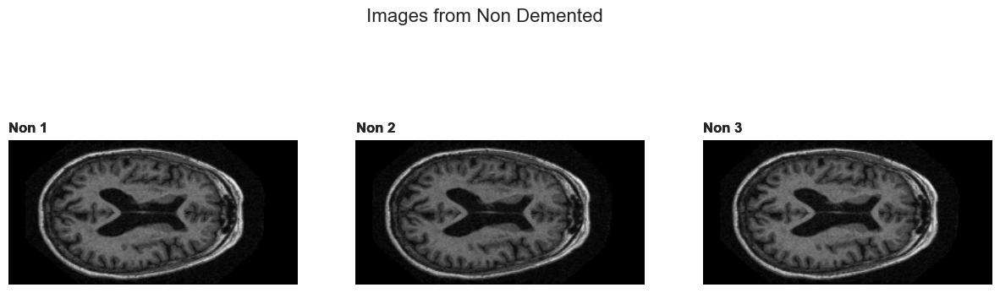

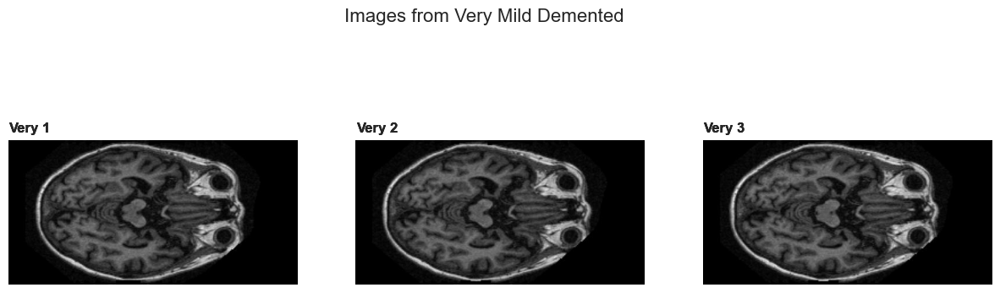

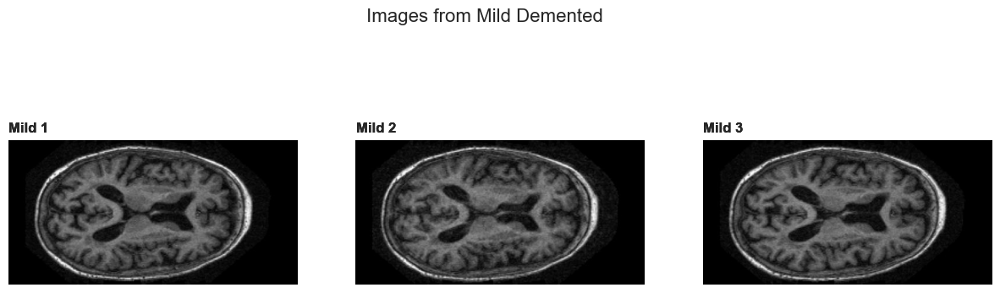

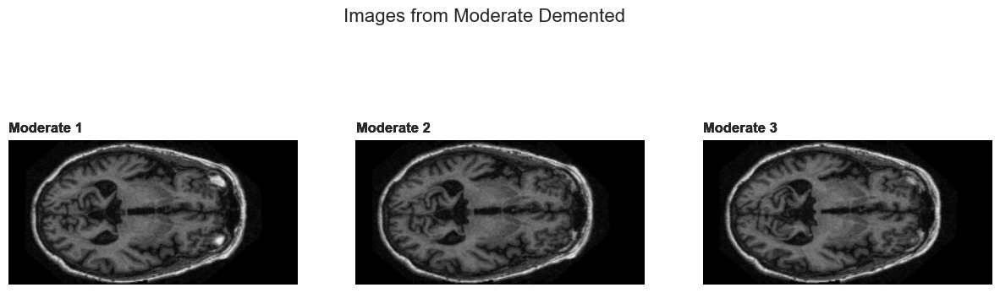

In [4]:
# Function to display images with text indicating the category
def display_images_with_text(file_paths, category_name, endings=['140', '141', '142']):
    plt.figure(figsize=(15, 5))
    plt.suptitle(f"Images from {category_name}", fontsize=16)

    for ending in endings:
        matching_files = [img for img in file_paths if img.endswith(ending + '.jpg')]
        for i in range(min(3, len(matching_files))):
            img_path = matching_files[i]
            img = Image.open(img_path)
            plt.subplot(1, 3, i + 1)
            plt.imshow(img)
            plt.axis('off')
            
            # Add text indicating the category
            plt.text(0, -10, f"{category_name.split()[0]} {i + 1}", fontsize=12, weight='bold', ha='left', va='bottom')

    plt.show()

# Display images with text for each category
display_images_with_text(non_demented, "Non Demented")
display_images_with_text(very_mild_demented, "Very Mild Demented")
display_images_with_text(mild_demented, "Mild Demented")
display_images_with_text(moderate_demented, "Moderate Demented")

In [5]:
pattern = re.compile('OAS1_(\d+)_MR(\d+)_mpr-(\d+)_(\d+).jpg')

def filename_info(filename, pattern=pattern):
    match = pattern.match(filename)
    if match:
        # Directly return the groups as a tuple
        return match.groups()
    else:
        raise ValueError("Filename does not match expected pattern")

In [6]:
def create_ref_df(dataset_path):
    
    data = []

    for folder in os.listdir(dataset_path):
        folder_path = os.path.join(dataset_path, folder)
        for file in os.listdir(folder_path):
            try:
                patient_id, mr_id, scan_id, layer_id = filename_info(file)
                data.append({
                    'path': os.path.join(folder_path, file),
                    'label': folder,
                    'patient_id': int(patient_id),
                    'mr_id': int(mr_id),
                    'scan_id': int(scan_id),
                    'layer_id': int(layer_id)
                })
            except ValueError:
                pass

    ref_df = pd.DataFrame(data)
    
    if not ref_df.empty:
        # I found it more efficient to convert types if DataFrame is not empty
        ref_df = ref_df.astype({
            'path': 'string',
            'label': 'string',
            'patient_id': 'int64',
            'mr_id': 'int64',
            'scan_id': 'int64',
            'layer_id': 'int64'
        })

    return ref_df

ref_df = create_ref_df('Data/oasis_data')

In [7]:
def load_images(ref_df):
    # Directly convert columns to lists (avoids iterrows)
    labels = ref_df['label'].tolist()
    paths = ref_df['path'].tolist()

    # Use a list comprehension for image loading
    images = [np.array(Image.open(path).convert('L')) for path in tqdm(paths, total=len(paths))]

    return images, labels, paths

In [8]:
images, labels, paths = load_images(ref_df)

100%|██████████| 86437/86437 [06:02<00:00, 238.42it/s]


In [9]:
def image_stats(images, labels, paths):
    # Pre-calculate properties that don't require intensive computation
    widths = [image.shape[0] for image in images]
    heights = [image.shape[1] for image in images]

    # Calculate mean, std, and skewness in a more compact form
    means = [np.mean(image) for image in images]
    stds = [np.std(image) for image in images]
    skewnesses = [skew(np.histogram(image.flatten())[0]) for image in tqdm(images)]

    # Assemble the DataFrame
    image_stats = pd.DataFrame({
        'mean': means,
        'std': stds,
        'width': widths,
        'height': heights,
        'skew': skewnesses,
        'label': labels,
        'path': paths
    })

    return image_stats

In [10]:
image_stats = image_stats(images, labels, paths)

100%|██████████| 86437/86437 [03:03<00:00, 470.98it/s]


In [11]:
px.box(image_stats, y='mean', x='label')


In [12]:
px.box(image_stats, y='std', x='label')


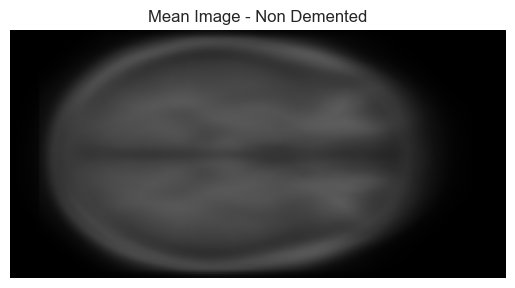

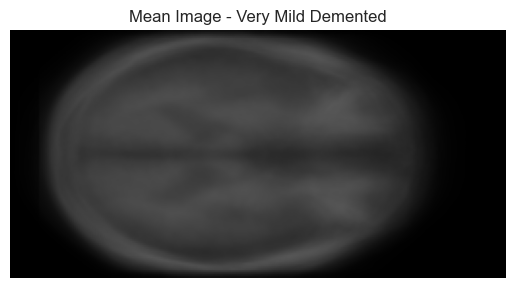

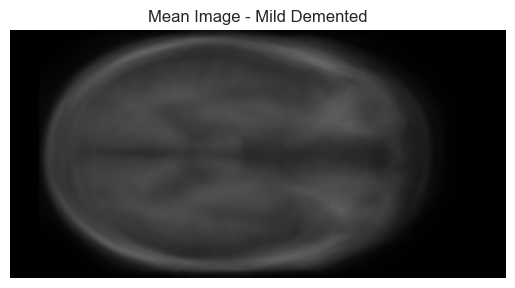

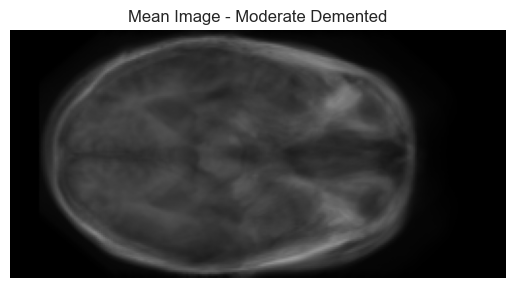

In [13]:
def visualize_class_distribution(categories, counts):

    plt.figure(figsize=(10, 6))
    plt.bar(categories, counts)
    plt.title('Image Counts by Category')
    plt.xlabel('Category')
    plt.ylabel('Number of Images')
    plt.xticks(rotation=45)
    plt.show()


def display_mean_images(class_lists, class_names):

    for class_list, class_name in zip(class_lists, class_names):
        class_images_data = [np.asarray(Image.open(img_path).convert('RGB')) for img_path in class_list]
        mean_image_data = np.mean(class_images_data, axis=0).astype(np.uint8)
        plt.imshow(mean_image_data)
        plt.title(f'Mean Image - {class_name}')
        plt.axis('off')
        plt.show()


image_paths = [non_demented, very_mild_demented, mild_demented, moderate_demented]
image_labels = ['Non Demented', 'Very Mild Demented', 'Mild Demented', 'Moderate Demented']

categories = ['Non Demented', 'Very Mild Demented', 'Mild Demented', 'Moderate Demented']
image_counts = [len(non_demented), len(very_mild_demented), len(mild_demented), len(moderate_demented)]



display_mean_images(image_paths, image_labels)
